In [1]:
import math
import pandas as pd
import numpy as np
import glob
import os  
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.graph_objects as go

In [2]:
# # merging the files
# joined_files = os.path.join("E:\Downloads\Academic\Year 4 - Second Term\THS-ST2\EDA\CSV", "*.csv")
# joined_list = glob.glob(joined_files)
# df = pd.concat(map(pd.read_csv, joined_list), ignore_index=True)

In [3]:
# # Export to CSV
# df.to_csv('compiled_dataset.csv')

In [4]:
df = pd.read_csv('compiled_dataset.csv', index_col=0)

In [5]:
df.shape

(330577, 14)

In [6]:
df.describe()

,face_index,x1,y1,x2,y2,x1_pad,y1_pad,x2_pad,y2_pad,pixels
count,330577.000000,330577.000000,330577.000000,330577.000000,330577.000000,330577.000000,330577.00000,330577.000000,330577.000000,330577.000000
mean,8.281481,169.583631,109.429733,244.756737,212.133936,132.828935,67.99892,281.530829,258.233201,16782.237863
std,25.368071,74.581305,63.080630,74.044201,71.741971,89.584612,81.90681,88.720682,94.008750,19638.795958
min,0.000000,-34.000000,-109.000000,4.000000,8.000000,0.000000,0.00000,6.000000,10.000000,0.000000
25%,0.000000,127.000000,63.000000,222.000000,160.000000,70.000000,0.00000,245.000000,183.000000,91.000000
50%,0.000000,155.000000,93.000000,258.000000,208.000000,112.000000,27.00000,302.000000,248.000000,9526.000000
75%,3.000000,193.000000,144.000000,285.000000,261.000000,171.000000,128.00000,342.000000,335.000000,27841.000000
max,299.000000,411.000000,404.000000,443.000000,519.000000,409.000000,401.00000,415.000000,415.000000,136924.000000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 330577 entries, 0 to 330576
Data columns (total 14 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   path           330577 non-null  object 
 1   source_file    330577 non-null  object 
 2   face_index     330577 non-null  int64  
 3   x1             330577 non-null  int64  
 4   y1             330577 non-null  int64  
 5   x2             330577 non-null  int64  
 6   y2             330577 non-null  int64  
 7   x1_pad         330577 non-null  int64  
 8   y1_pad         330577 non-null  int64  
 9   x2_pad         330577 non-null  int64  
 10  y2_pad         330577 non-null  int64  
 11  mask_filename  330577 non-null  object 
 12  filename       330577 non-null  object 
 13  pixels         330577 non-null  float64
dtypes: float64(1), int64(9), object(4)
memory usage: 37.8+ MB


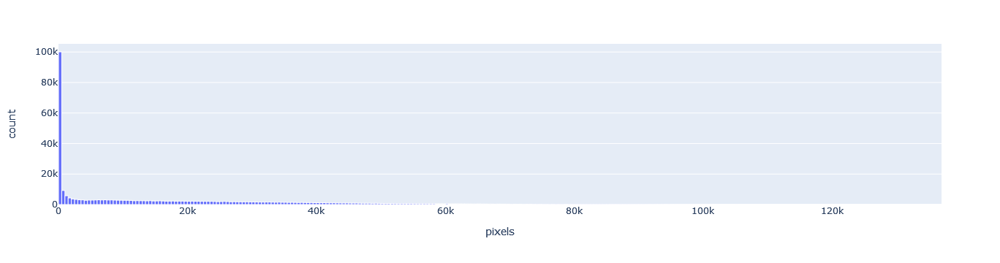

In [8]:
bar_fig = px.histogram(df, x="pixels")
bar_fig.update_traces(marker_line_width=1, marker_line_color="white")
bar_fig.show()

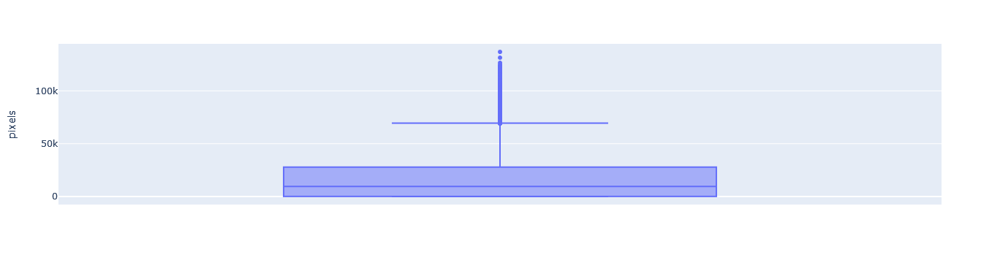

In [9]:
box_fig = px.box(df, y="pixels")
box_fig.show()

In [10]:
df['log_pixels'] = df['pixels']
df['log_pixels'] = df['log_pixels'].replace(0, 1)
df['log_pixels'] = np.log(df['log_pixels'])

In [11]:
min_val = df['log_pixels'].min()
max_val = df['log_pixels'].max()
df['log_pixels'].unique()

array([ 0.        ,  6.8793558 ,  6.83947644, ..., 11.06785637,
       10.32255966,  7.99665388])

In [12]:
# Sturge's rule
bin_count = 1 + math.ceil(np.log2(df.shape[0]))
print(bin_count)

20


In [13]:
labels = np.arange(0, 20)
bins = np.linspace(min_val, max_val, bin_count + 1)
df['bins'] = pd.cut(df['log_pixels'], bins=bins, labels=labels, include_lowest=True)

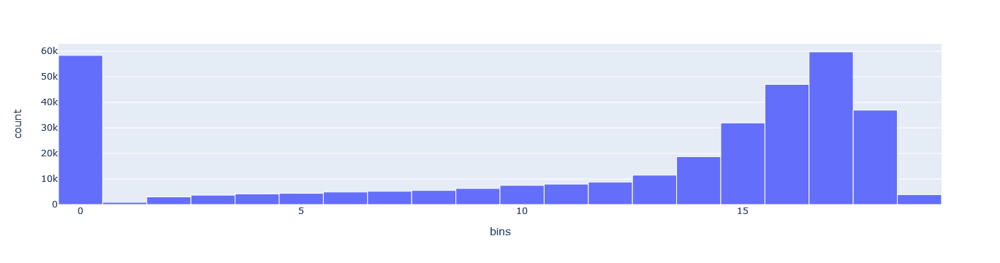

In [14]:
bar_fig = px.histogram(df, x="bins")
bar_fig.update_traces(marker_line_width=1, marker_line_color="white")
bar_fig.show()

In [15]:
df['bins'].describe()

count     330577
unique        20
top           17
freq       59732
Name: bins, dtype: int64

In [26]:
g = df.groupby('bins')
int(g.size().mean())

16528

In [29]:
# IF YOU WANT THE DISTRIBUTRION TO BE ACCORDING TO MEAN
g = df.groupby('bins')
g = g.apply(lambda x: x.sample(min(int(g.size().mean()), len(x))).reset_index(drop=True))

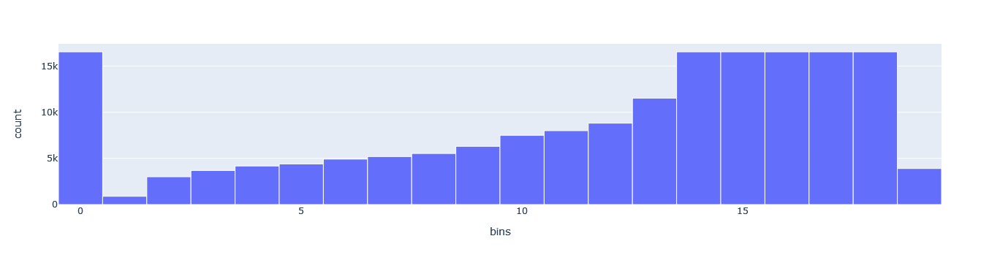

In [30]:
bar_fig = px.histogram(g, x="bins")
bar_fig.update_traces(marker_line_width=1, marker_line_color="white")
bar_fig.show()

In [32]:
g.describe()

,face_index,x1,y1,x2,y2,x1_pad,y1_pad,x2_pad,y2_pad,pixels,log_pixels
count,176992.000000,176992.000000,176992.000000,176992.000000,176992.000000,176992.000000,176992.000000,176992.000000,176992.000000,176992.000000,176992.000000
mean,6.423223,175.606061,113.499260,240.070602,201.443545,144.235683,77.724151,271.469083,240.126147,13369.851151,7.077656
std,20.007747,79.826480,64.782208,78.990581,74.321510,92.993691,81.397355,91.608212,93.484720,20096.651055,3.414053
min,0.000000,-34.000000,-109.000000,4.000000,8.000000,0.000000,0.000000,6.000000,10.000000,0.000000,0.000000
25%,0.000000,127.000000,64.000000,208.000000,147.000000,75.000000,0.000000,225.000000,168.000000,133.000000,4.890349
50%,0.000000,162.000000,100.000000,252.000000,193.000000,129.000000,52.000000,287.000000,221.000000,3609.000000,8.191186
75%,3.000000,210.000000,153.000000,287.000000,250.000000,193.000000,140.000000,339.000000,307.000000,18485.250000,9.824728
max,299.000000,411.000000,404.000000,443.000000,519.000000,409.000000,399.000000,415.000000,415.000000,136924.000000,11.827181


In [33]:
# IF YOU WANT THE DISTRIBUTRION TO BE ACCORDING TO MIN
g = df.groupby('bins')
g = g.apply(lambda x: x.sample(g.size().min()).reset_index(drop=True))

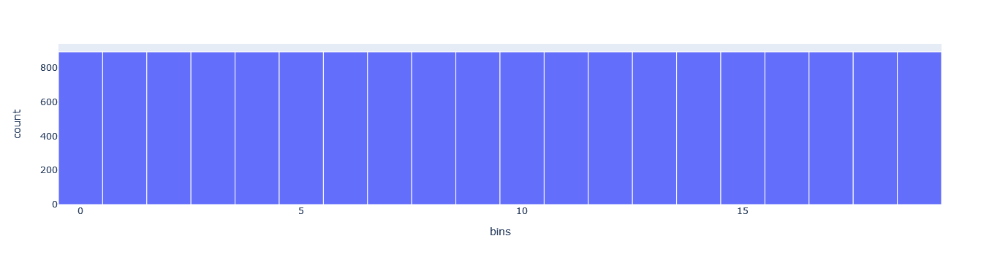

In [34]:
bar_fig = px.histogram(g, x="bins")
bar_fig.update_traces(marker_line_width=1, marker_line_color="white")
bar_fig.show()

In [35]:
g.describe()

,face_index,x1,y1,x2,y2,x1_pad,y1_pad,x2_pad,y2_pad,pixels,log_pixels
count,17860.000000,17860.000000,17860.000000,17860.000000,17860.000000,17860.000000,17860.000000,17860.000000,17860.000000,17860.000000,17860.000000
mean,8.135386,183.499552,131.037066,232.695745,198.091153,159.831915,104.247312,256.397256,225.495073,10543.295353,5.891211
std,18.672874,92.321701,68.040491,91.619266,75.984768,103.751309,84.321462,102.558932,91.569581,21871.968996,3.427788
min,0.000000,-17.000000,-58.000000,6.000000,9.000000,0.000000,0.000000,8.000000,13.000000,0.000000,0.000000
25%,0.000000,119.000000,79.000000,170.000000,144.000000,77.000000,15.000000,180.000000,160.000000,19.750000,2.982909
50%,1.000000,168.000000,123.000000,248.000000,188.000000,144.000000,106.000000,272.000000,205.000000,370.500000,5.914853
75%,8.000000,248.000000,176.000000,296.000000,242.000000,238.000000,167.000000,338.000000,276.000000,7115.000000,8.869960
max,250.000000,410.000000,397.000000,421.000000,467.000000,409.000000,393.000000,415.000000,415.000000,126582.000000,11.748646
